# Flood area segmentation using DeepLabV3 with Cartagena flood images

We are training a model using DeepLabV3 architecture to identify potential flooding sources in the city of Cartagena, Colombia

*   The task is to create a segmentation model, which can accurately segment out the water region in a given picture of a flood hit area, specially identifying Cartagena's most unique features.

### Use case

* This models can be used to prevent and identify the flood areas in the city, which can cause problems in areas such as mobility, health, etc.

### Data distribution

The data is distributed in 2 folders, which are inside the semantic_segmentation/inundaciones path :
* image: contains the dataset images.
* mask: contains the binary masks with  the delimitided flood areas.
* **metadata.csv**: A csv file mapping the image name with its mask.

### Approach

1. Data Loading
  * The first step is to load images with their respective masks.
2. Data Visualization
  * In this step we will visualise the images with their respective masks so that we can better understand the flood problem.
3. DeepLabV3
  * From here we will shift our focus from data model building. As this is an image segmentation task. We have chosen DeepLabV3 model, we will create, train, optimize and evaluate this model.
4. Predictions
  * At last we will visualize the prediction made by the model

### Imports


Here are the imports and libraries we use in this notebook:

In [22]:
from IPython.display import clear_output as cls

!pip install tf_explain

# For formatting
cls()

In [23]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

# Data
from tqdm import tqdm
from glob import glob
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visulization
import matplotlib.pyplot as plt

# Model Layers
from keras.models import Model
from keras.layers import Layer
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU, ReLU
from keras.models import Sequential

# Backbone
from tensorflow.keras.applications import ResNet50

# Model Architecture Visualization
from tensorflow.keras.utils import plot_model

# Optimizer
from tensorflow.keras.optimizers import Adam

# Callbacks
from keras.callbacks import ModelCheckpoint, Callback

# Model Layer Visualization
from tf_explain.core.grad_cam import GradCAM

### Data loading

In order to work on the model, first we need to load our data.

In [24]:
import sys
PATH = os.getcwd()
DIR_DATA = PATH + '{0}semantic_segmentation_data'.format(os.sep)
sys.path.append(PATH) if PATH not in list(sys.path) else None
print(f"Current working directory: {PATH}")
# Specify paths
root_path = DIR_DATA
print(f"Root path: {root_path}")
image_path = DIR_DATA + '{0}Image'.format(os.sep)
print(f"Image route: {image_path}")
mask_path = DIR_DATA + '{0}Mask'.format(os.sep)
print(f"Mask route: {mask_path}")
metadata_path = DIR_DATA + '{0}metadata.csv'.format(os.sep)
print(f"Metadata route: {metadata_path}")

Current working directory: c:\Users\usuario\Documents\DeepFlood
Root path: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data
Image route: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data\Image
Mask route: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data\Mask
Metadata route: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data\metadata.csv


Let's see whats inside the metadada.csv:


In [25]:
# Load file
metadata = pd.read_csv(metadata_path)

# Show
metadata

,Image,Mask
0,0.jpg,0.png
1,1.jpg,1.png
2,2.jpg,2.png
3,3.jpg,3.png
4,4.jpg,4.png
5,5.jpg,5.png
6,6.jpg,6.png
7,7.jpg,7.png
8,8.jpg,8.png
9,9.jpg,9.png


In [26]:
metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41 entries, 0 to 40
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Image   41 non-null     object
 1   Mask    41 non-null     object
dtypes: object(2)
memory usage: 784.0+ bytes


In [6]:
metadata.describe()

,Image,Mask
count,41,41
unique,41,41
top,0.jpg,0.png
freq,1,1


This file has the **image file name** and it's respective **mask file name**. Although we can use this **metadata file** for **loading our images and their respective masks**, I have a **better option**. Let's create a function to load the **complete data**.

In [27]:
# This is a helper function
def load_image(path:str, SIZE:tuple = (256, 256), mask:bool = False):

    '''
    This function is responsible for loading and processing the image. The function takes in the path of the
    image to be loaded and then loads the image using OpenCV, perform a resize conversionn and cast the image
    to a 32Bit Float Tensor. At last, the image is normalized to change the pixel range from 0 to 255 to
    0 to 1.

    Inputs :
        path : It represents the file path of he image to be loaded.
        size : The desired size in which the image should be resized, default is set to 256 x 256 pixels.
        mask : If the image to be loaded is then the image is a binary map i.e of shape = (*size, 1)

    Output:
        image : The processed image whose file path was provided.
    '''

    # load Image
    image = load_img(path)

    # Convert to an array
    image = img_to_array(image)

    # Resize the image
    image = tfi.resize(image, SIZE)

    # Convert to Tensor of 32Bit - Float
    image = tf.cast(image, tf.float32)

    # Normalize the image
    image = image/255.

    # Mask
    if mask:
        image = image[:, :, :1]

    # return image
    return image

In [28]:
def load_data(root_path:str=root_path):

    '''
    The function is reponsible for loading all the Images and their respective Masks. It does so by first load the file paths of the Images
    then it applies some changes on the Image paths to convert them to Mask Paths. Before loading the Images and Masks, first a empty space
    is created, where the loaded Images and Masks are stored. As last it returns the array of Images and Masks.

    Input :
        root_path : The path to the main directory where both the images & masks are kept.

    Outputs :
        images : Array of all the images present in the data set.
        masks : Array of all the masks present in the data set.
    '''

    # Load the Image and Mask paths
    image_paths = sorted(glob(root_path + "\\Image\\*.jpg"))
    mask_paths  = [path.replace("Image", "Mask").replace("jpg", "png") for path in image_paths]

    # Create space for loading the images and masks
    images = np.empty(shape=(len(image_paths), 256, 256, 3), dtype=np.float32)
    masks  = np.empty(shape=(len(image_paths), 256, 256, 1), dtype=np.float32)

    # load the images and masks
    for i, (img_path, mask_path) in tqdm(enumerate(zip(image_paths, mask_paths)), desc="Loading"):

        # Load the image
        image = load_image(path = img_path, mask = False)

        # Load the respective mask
        mask  = load_image(path = mask_path, mask = True)

        # Put this into the Space
        images[i] = image
        masks[i]  = mask

    # Return the images and Masks
    return images, masks

Now we can see how it works: 

In [29]:
# Colect All images and masks
all_images, all_masks = load_data(root_path)

Loading: 41it [00:00, 65.66it/s]


We need to split the data in order to evaluate it's performance:

In [30]:
# Split data into Training and Testing
data_len = len(all_images)
print("Total Data Length : ", data_len)

# Training set
train_images, train_masks = all_images[:int(data_len*0.8)], all_masks[:int(data_len*0.8)]

# Testing Set
test_images,  test_masks = all_images[int(data_len*0.8):], all_masks[int(data_len*0.8):]

Total Data Length :  41


### Data visualization

In [31]:
def show_images(images, masks, n_images, SIZE=(15,8)) -> None:

    '''
    This function is responsible for visualising N number of images from the given set of Images and the respective masks.
    It does so by plotting the images and masks using matplotlib.

    Inputs :
        images   : The collection of images.
        masks    : The collection of masks.
        n_images : Total number of images to be plotted.
        SIZE     : Size of each plot.

    '''

    # Plot n Images
    for i in range(n_images):

        # Plotting Configuration
        plt.figure(figsize=SIZE)

        # Select a image Randomly
        id = np.random.randint(len(images))

        # Plot the Image
        plt.subplot(1, 3, 1)
        plt.imshow(images[id])
        plt.title("Image")
        plt.axis('off')

        # Plot the Mask
        plt.subplot(1, 3, 2)
        plt.imshow(masks[id], cmap='gray')
        plt.title("Mask")
        plt.axis('off')

        # Plot the Overlapping Mask
        plt.subplot(1, 3, 3)
        plt.imshow(images[id], cmap='gray')
        plt.imshow(masks[id], cmap='gray', alpha=0.5)
        plt.title("Overlapping Mask")
        plt.axis('off')

        # Shwo a Single Frame : This is done to speed up plotting for large number images
        plt.tight_layout()
        plt.show()

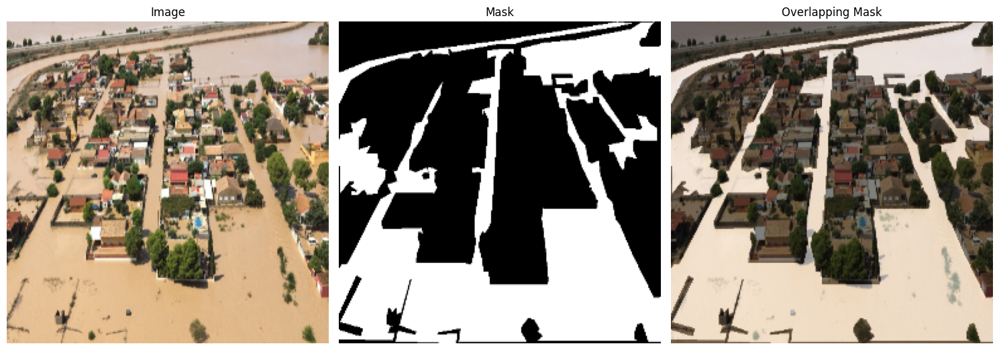

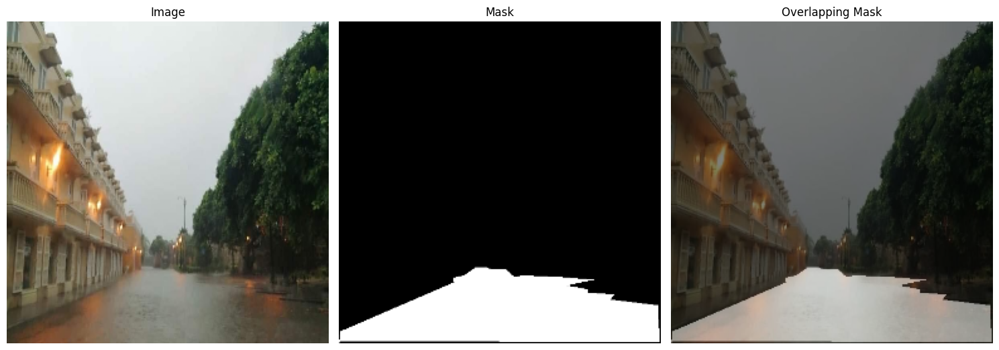

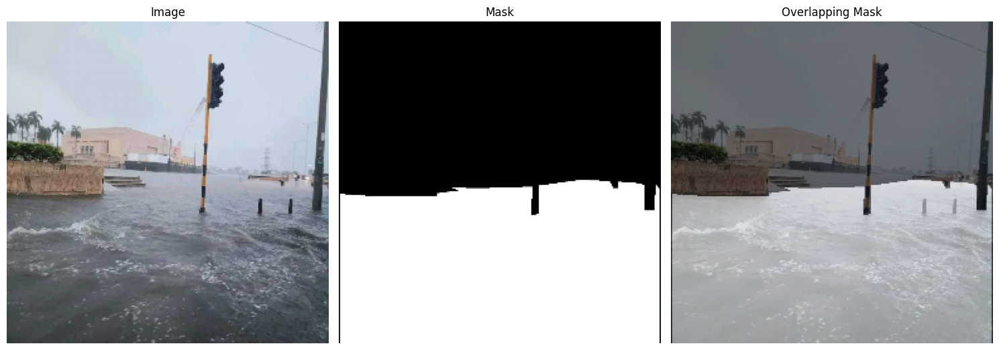

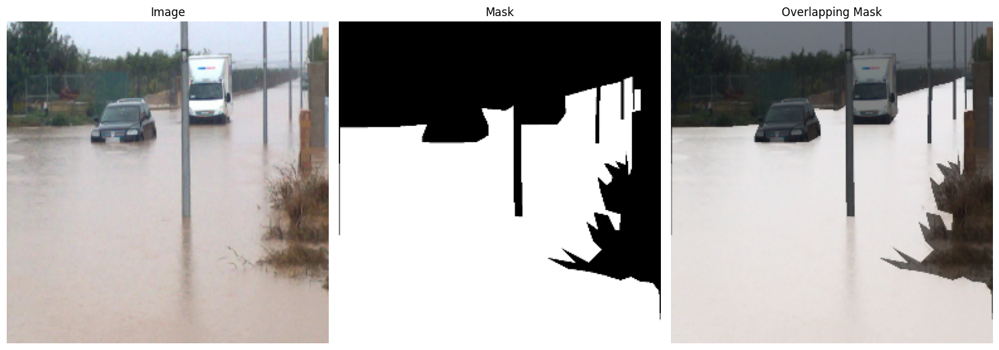

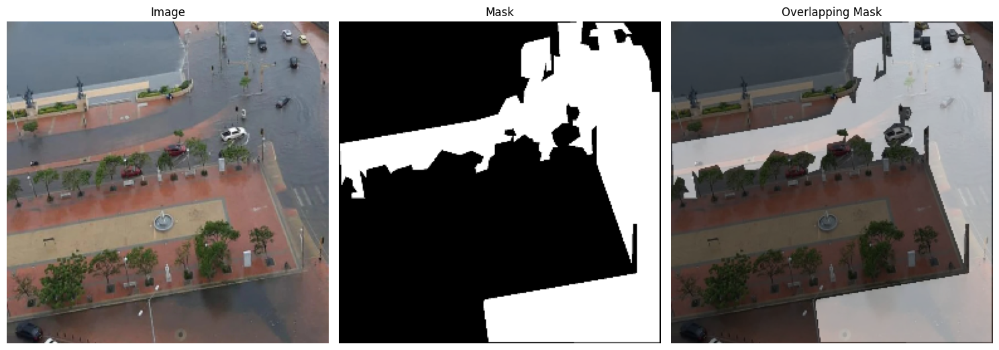

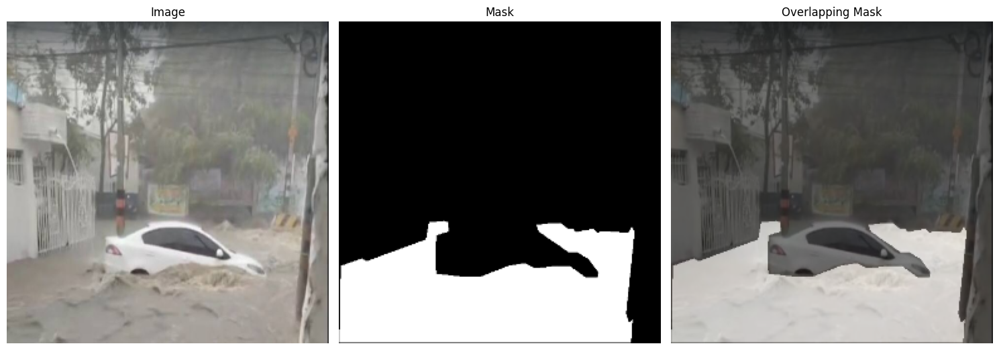

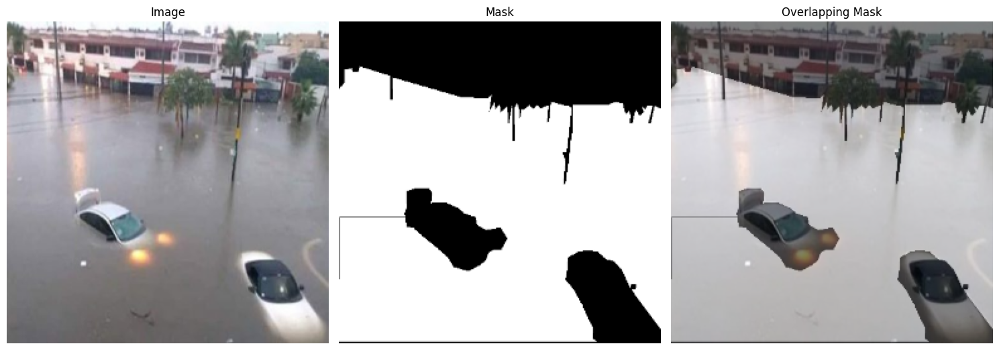

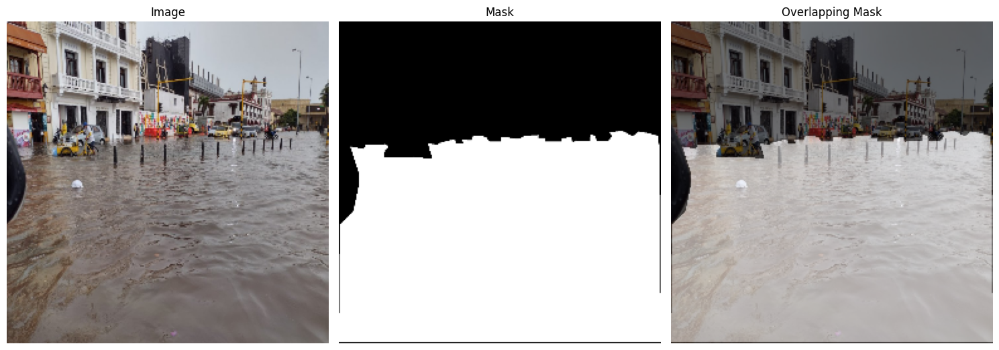

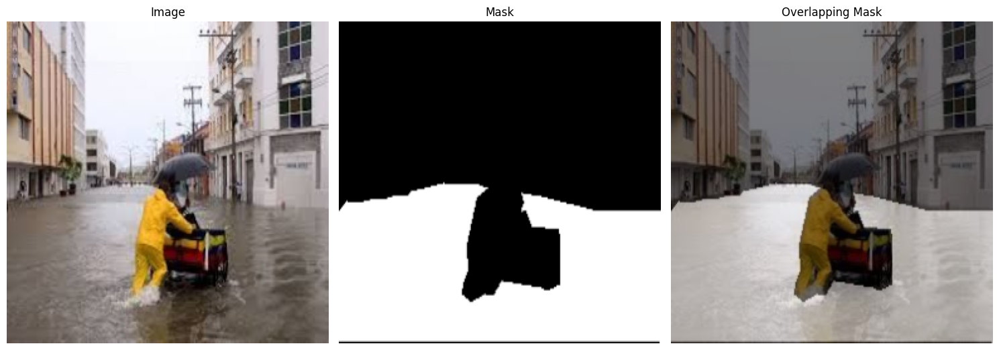

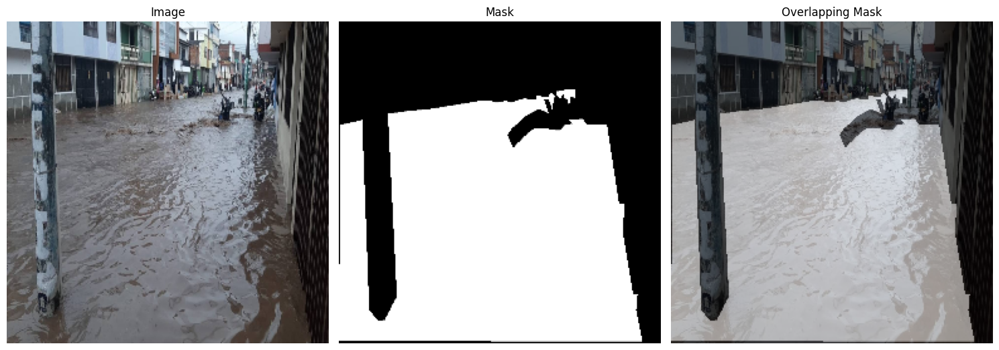

In [32]:
show_images(train_images, train_masks, n_images=10)

# **DeepLabV3+**

In [33]:
class ConvBlock(Layer):

    '''
    As in the Model implementation uses, Conv2D -> BatchNormalization -> ReLU. In the same fashion again and again, that why we have created a Single Layer
    which apply this operation. So ConvBlock = Conv2D -> BatchNormalization -> ReLU. This helps us in implementation.
    '''

    def __init__(self, filters:int = 256, kernel_size:int = 3, dilation_rate:int = 1, **kwargs) -> None:
        super(ConvBlock, self).__init__(**kwargs)

        # Define Parameters
        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        # Define the model
        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', strides=1, dilation_rate=dilation_rate, activation=None, use_bias=False),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        # Apply the layers
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()

        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate
        }

Now we need to define our ASPP module:

In [34]:
def AtrousSpatialPyramidPooling(X):

    # Shape
    _, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-ImagePool-AP")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[1]), name="ASPP-ImagePool-US")(image_pool)

    # Astrous Layers
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-Conv1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-Conv6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-Conv12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-Conv18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Concatenate")([image_pool, conv_1, conv_6, conv_12, conv_18])
    output = ConvBlock(kernel_size=1, name="ASPP-Out")(combined)

    return output

We have ***sub-layers*** defined, now we need to combine them to create our ***Encoder-Decoder model.***

In [35]:
# Model Specifications
IMAGE_SIZE = 256
MODEL_NAME = "DeepLab-FloodArea"

# Input Layer
inputs = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Backbone
backbone = ResNet50(input_tensor=inputs, weights='imagenet', include_top=False)

# High Level Features
DCNN = backbone.get_layer('conv4_block6_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(
    IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]
), name="ASPP-UpSample-Out")(ASPP)

# Low Level Features
LLF = backbone.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combine
concat = Concatenate(axis=-1, name="Concat-LLF-HLF")([LLF, ASPP])
y = ConvBlock(name="TopConvBlock1")(concat)
y = ConvBlock(name="TopConvBlock2")(y)
y = UpSampling2D(size=(
    IMAGE_SIZE//y.shape[1], IMAGE_SIZE//y.shape[2]
), name="Feature-UpSample")(y)

# Output Layer
output = Conv2D(filters=1, kernel_size=3, padding='same', activation='sigmoid', use_bias=False, name="OutputLayer")(y)

# Model
DeepLabV3 = Model(inputs, output, name=MODEL_NAME)

Let's see how is structured our model's architecture:

In [17]:
DeepLabV3.summary()

Model: "DeepLab-FloodArea"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ InputLayer          │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ InputLayer[0][0]  │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 11,854,144 (45.22 MB)

 Trainable params: 11,821,408 (45.10 MB)

 Non-trainable params: 32,736 (127.88 KB)

### DeepLabV3+ Visualization

In [36]:
import os
os.system("dot -V")  # dot es el ejecutable principal de Graphviz

%pip install pydot
%pip install graphviz
import pydot
import graphviz
# Plot the Model
plot_model(DeepLabV3, MODEL_NAME+".png", dpi=96, show_shapes=True)

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


This the model architecture. Now we can focus on the training phase:

### Model Callback

Now it's training time, we could see the progress of this training session throughout some plots of those predictions

In [37]:
# severity classification
def severity(flood_percent:float) -> None:
    if flood_percent <= 10:
        severidad = "Baja"
        color = "🔵"
    elif flood_percent <= 30:
        severidad = "Moderada"
        color = "🟡"
    elif flood_percent <= 60:
        severidad = "Alta"
        color = "🟠"
    else:
        severidad = "Crítica"
        color = "🔴"

    print(f"Severidad: {severidad} {color}")

In [38]:
def show_model_preds(images, masks, model, SIZE:tuple = (15,8)) -> None:
    # Collect Image and Mask
    id = np.random.randint(len(test_images))
    image, mask = images[id], masks[id]

    # Make Prediction
    pred_mask = model.predict(tf.expand_dims(image, axis=0))

    # Calcular porcentaje de inundación vs no inundación
    pred_mask_binary = tf.squeeze(pred_mask).numpy()
    pred_mask_binary = (pred_mask_binary > 0.5).astype(int)  # umbral si la salida es continua

    total_pixels = pred_mask_binary.size
    flood_pixels = np.sum(pred_mask_binary == 1)
    non_flood_pixels = total_pixels - flood_pixels

    flood_percent = (flood_pixels / total_pixels) * 100
    non_flood_percent = 100 - flood_percent

    print(f"Porcentaje de inundación: {flood_percent:.2f}%")
    print(f"Porcentaje sin inundación: {non_flood_percent:.2f}%")

    # Severity Classification
    severity(flood_percent)

    # Grad CAM
    cam = GradCAM()
    capture = cam.explain(
        validation_data=(tf.expand_dims(image, axis=0).numpy(), mask),
        model=model,
        class_index=1,
        layer_name="TopConvBlock2"
    )

    # Plot Size
    plt.figure(figsize=SIZE)

    # Plot Image
    plt.subplot(1,4,1)
    plt.imshow(image)
    plt.title("Input Image")
    plt.axis('off')

    # Plot Original Mask
    plt.subplot(1,4,2)
    plt.title("Expected Mask")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    # Plot Predicted Mask
    plt.subplot(1,4,3)
    plt.imshow(tf.squeeze(pred_mask), cmap='gray')
    plt.title("Predicted Mask")
    plt.axis('off')

    # Grad CAM
    plt.subplot(1,4,4)
    plt.title("Grad CAM Visualization")
    plt.imshow(tf.squeeze(capture))
    plt.axis('off')

    # Show the Final Plot
    plt.show()


In [39]:
class ShowProgress(Callback):

    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_model_preds(test_images, test_masks, self.model)

Epoch 1/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 777ms/step - loss: 0.5335

16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - loss: 0.5270 - val_loss: 219.5952
Epoch 2/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 765ms/step - loss: 0.2340

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 899ms/step - loss: 0.2364 - val_loss: 8.4771
Epoch 3/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 790ms/step - loss: 0.2125

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 933ms/step - loss: 0.2131 - val_loss: 5.2184
Epoch 4/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 761ms/step - loss: 0.2180

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 902ms/step - loss: 0.2176 - val_loss: 3.3371
Epoch 5/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 755ms/step - loss: 0.2038

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 892ms/step - loss: 0.2026 - val_loss: 0.8073
Epoch 6/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 769ms/step - loss: 0.1526

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 905ms/step - loss: 0.1529 - val_loss: 0.5287
Epoch 7/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 856ms/step - loss: 0.1235 - val_loss: 1.0660
Epoch 8/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 747ms/step - loss: 0.1070

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 886ms/step - loss: 0.1078 - val_loss: 0.4561
Epoch 9/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 868ms/step - loss: 0.1200 - val_loss: 1.2354
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step/step - loss: 0.123
Porcentaje de inundación: 21.25%
Porcentaje sin inundación: 78.75%
Severidad: Moderada 🟡


c:\Users\usuario\Documents\DeepFlood\.venv\lib\site-packages\keras\src\models\functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['InputLayer']]
Received: inputs=['Tensor(shape=(1, 256, 256, 3))']
  warnings.warn(msg)


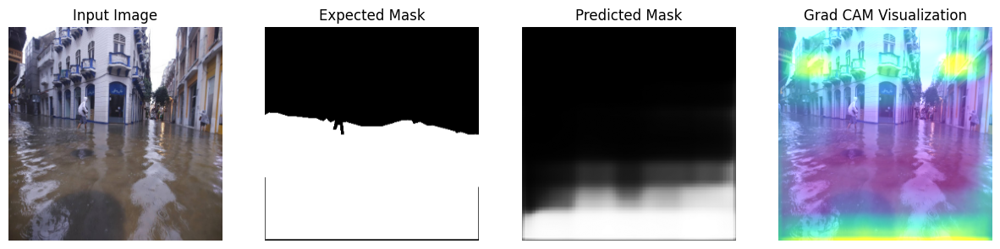

16/16 ━━━━━━━━━━━━━━━━━━━━ 18s 1s/step - loss: 0.1243 - val_loss: 0.7805
Epoch 11/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 844ms/step - loss: 0.1196 - val_loss: 0.5406
Epoch 12/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 848ms/step - loss: 0.1038 - val_loss: 0.8882
Epoch 13/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 855ms/step - loss: 0.0766 - val_loss: 0.7088
Epoch 14/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 856ms/step - loss: 0.0743 - val_loss: 1.3736
Epoch 15/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 872ms/step - loss: 0.0854 - val_loss: 1.9208
Epoch 16/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 875ms/step - loss: 0.1715 - val_loss: 0.5143
Epoch 17/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 865ms/step - loss: 0.1314 - val_loss: 0.5646
Epoch 18/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 838ms/step - loss: 0.1178 - val_loss: 0.5863
Epoch 19/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 836ms/step - loss: 0.1082 - val_loss: 0.7780
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/stepep - loss: 0.07
Porcentaje de inundación: 32.80%
Porcentaje sin inundación:

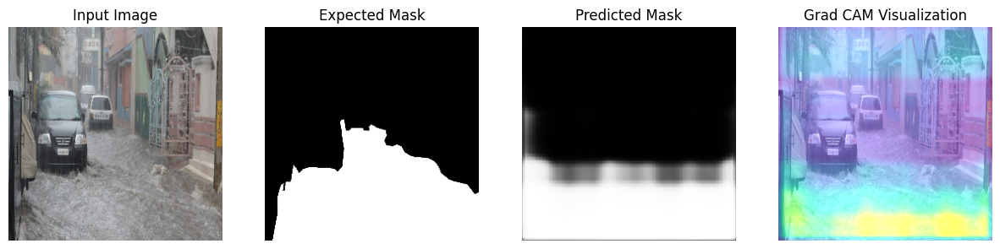

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 983ms/step - loss: 0.0728 - val_loss: 0.8799
Epoch 21/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 840ms/step - loss: 0.0854 - val_loss: 1.4200
Epoch 22/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 868ms/step - loss: 0.0725 - val_loss: 1.5443
Epoch 23/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 846ms/step - loss: 0.0709 - val_loss: 2.1995
Epoch 24/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 856ms/step - loss: 0.0950 - val_loss: 2.3442
Epoch 25/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 840ms/step - loss: 0.0689 - val_loss: 2.1629
Epoch 26/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 862ms/step - loss: 0.0764 - val_loss: 2.1385
Epoch 27/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 859ms/step - loss: 0.0588 - val_loss: 1.7208
Epoch 28/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 874ms/step - loss: 0.0574 - val_loss: 1.5100
Epoch 29/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 846ms/step - loss: 0.0530 - val_loss: 0.8953
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 665ms/stepep - loss: 0.04
Porcentaje de inundación: 16.12%
Porcentaje sin inundaci

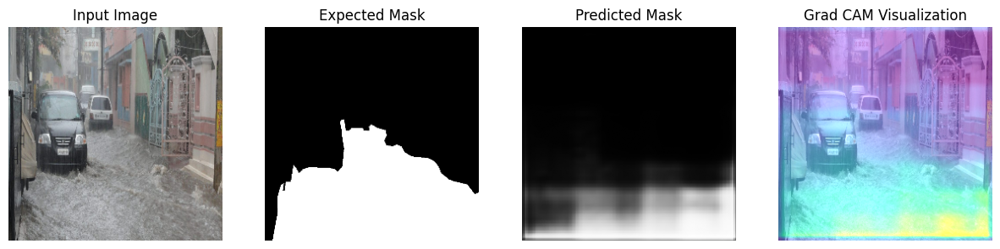

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 979ms/step - loss: 0.0452 - val_loss: 0.8802
Epoch 31/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 847ms/step - loss: 0.0487 - val_loss: 0.9101
Epoch 32/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 854ms/step - loss: 0.0510 - val_loss: 0.9032
Epoch 33/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 836ms/step - loss: 0.0374 - val_loss: 0.6898
Epoch 34/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 840ms/step - loss: 0.0387 - val_loss: 0.6705
Epoch 35/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 834ms/step - loss: 0.0388 - val_loss: 0.6173
Epoch 36/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 851ms/step - loss: 0.0345 - val_loss: 0.5629
Epoch 37/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 834ms/step - loss: 0.0327 - val_loss: 0.6029
Epoch 38/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 858ms/step - loss: 0.0492 - val_loss: 0.5890
Epoch 39/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 850ms/step - loss: 0.0402 - val_loss: 0.4938
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/stepep - loss: 0.03
Porcentaje de inundación: 15.66%
Porcentaje sin inundaci

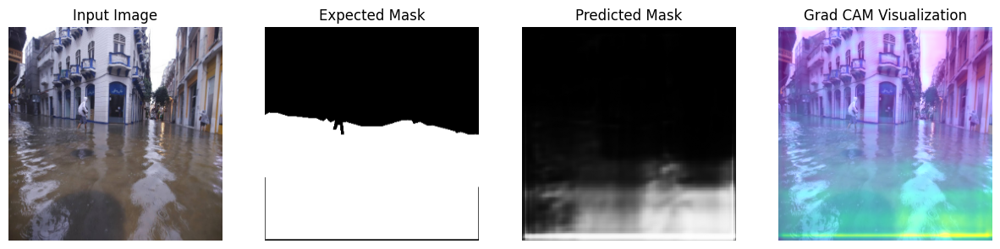

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 997ms/step - loss: 0.0365 - val_loss: 0.7482
Epoch 41/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 838ms/step - loss: 0.0299 - val_loss: 0.5476
Epoch 42/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 857ms/step - loss: 0.0343 - val_loss: 0.4665
Epoch 43/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 778ms/step - loss: 0.0304

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 925ms/step - loss: 0.0304 - val_loss: 0.4212
Epoch 44/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 883ms/step - loss: 0.0264 - val_loss: 0.4270
Epoch 45/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 768ms/step - loss: 0.0285

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 910ms/step - loss: 0.0286 - val_loss: 0.4119
Epoch 46/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 891ms/step - loss: 0.0315 - val_loss: 0.4130
Epoch 47/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 870ms/step - loss: 0.0232 - val_loss: 0.4462
Epoch 48/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 919ms/step - loss: 0.0292 - val_loss: 0.4413
Epoch 49/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 891ms/step - loss: 0.0261 - val_loss: 0.4128
Epoch 50/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 767ms/step - loss: 0.0318

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
Porcentaje de inundación: 29.93%
Porcentaje sin inundación: 70.07%
Severidad: Moderada 🟡


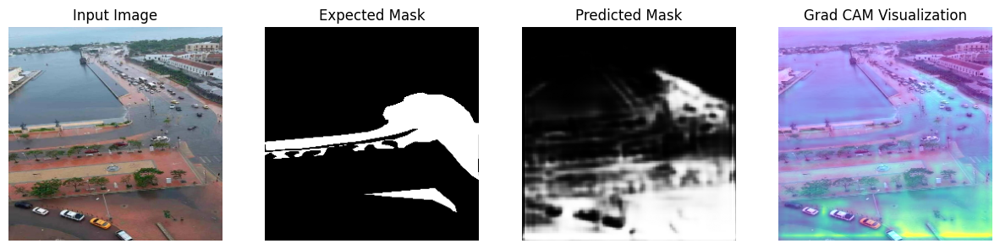

16/16 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - loss: 0.0316 - val_loss: 0.3890
Epoch 51/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 744ms/step - loss: 0.0268

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 884ms/step - loss: 0.0269 - val_loss: 0.3811
Epoch 52/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 785ms/step - loss: 0.0225

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 921ms/step - loss: 0.0228 - val_loss: 0.3789
Epoch 53/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 881ms/step - loss: 0.0221 - val_loss: 0.3845
Epoch 54/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 885ms/step - loss: 0.0274 - val_loss: 0.3797
Epoch 55/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 773ms/step - loss: 0.0240

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 914ms/step - loss: 0.0241 - val_loss: 0.3622
Epoch 56/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 884ms/step - loss: 0.0275 - val_loss: 0.3851
Epoch 57/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 756ms/step - loss: 0.0230

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 893ms/step - loss: 0.0231 - val_loss: 0.3482
Epoch 58/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 770ms/step - loss: 0.0253

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 907ms/step - loss: 0.0253 - val_loss: 0.3369
Epoch 59/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 893ms/step - loss: 0.0201 - val_loss: 0.3545
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/stepep - loss: 0.02
Porcentaje de inundación: 48.51%
Porcentaje sin inundación: 51.49%
Severidad: Alta 🟠


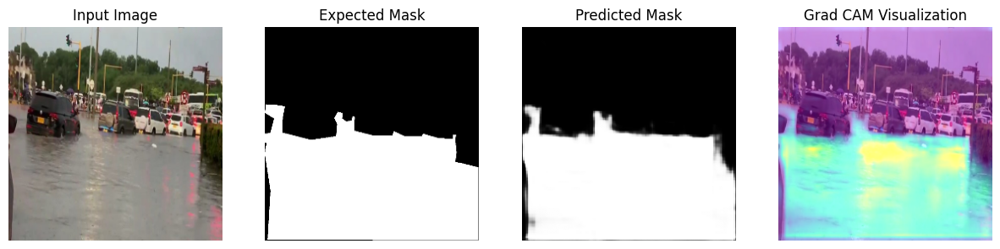

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0256 - val_loss: 0.3601
Epoch 61/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 873ms/step - loss: 0.0205 - val_loss: 0.3431
Epoch 62/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 906ms/step - loss: 0.0229 - val_loss: 0.3594
Epoch 63/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 898ms/step - loss: 0.0261 - val_loss: 0.3555
Epoch 64/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 887ms/step - loss: 0.0236 - val_loss: 0.3806
Epoch 65/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 859ms/step - loss: 0.0225 - val_loss: 0.4397
Epoch 66/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 850ms/step - loss: 0.0278 - val_loss: 0.3943
Epoch 67/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 849ms/step - loss: 0.0221 - val_loss: 0.4461
Epoch 68/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 851ms/step - loss: 0.0249 - val_loss: 0.4314
Epoch 69/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 853ms/step - loss: 0.0197 - val_loss: 0.4443
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 736ms/stepep - loss: 0.02
Porcentaje de inundación: 34.07%
Porcentaje sin inundación:

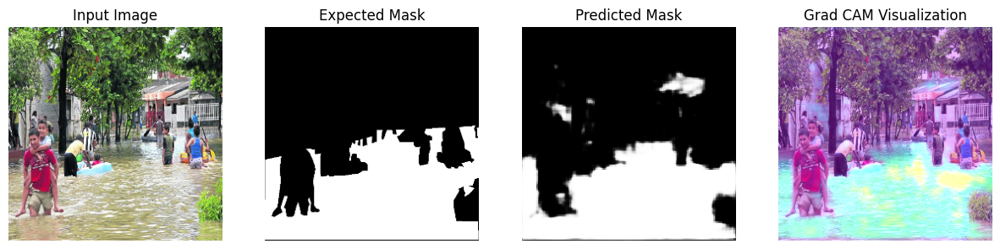

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0248 - val_loss: 0.4429
Epoch 71/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 892ms/step - loss: 0.0229 - val_loss: 0.4804
Epoch 72/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 886ms/step - loss: 0.0221 - val_loss: 0.4779
Epoch 73/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 881ms/step - loss: 0.0207 - val_loss: 0.4674
Epoch 74/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 900ms/step - loss: 0.0174 - val_loss: 0.4994
Epoch 75/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 916ms/step - loss: 0.0187 - val_loss: 0.4606
Epoch 76/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 873ms/step - loss: 0.0179 - val_loss: 0.5173
Epoch 77/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 868ms/step - loss: 0.0207 - val_loss: 0.5246
Epoch 78/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 850ms/step - loss: 0.0203 - val_loss: 0.5338
Epoch 79/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 863ms/step - loss: 0.0212 - val_loss: 0.5471
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 719ms/stepep - loss: 0.01
Porcentaje de inundación: 39.38%
Porcentaje sin inundación:

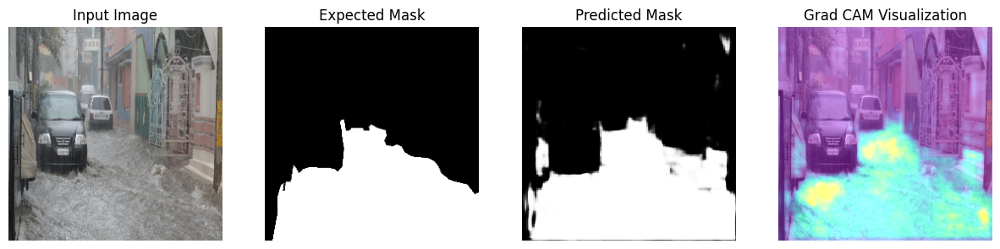

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0193 - val_loss: 0.5029
Epoch 81/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 842ms/step - loss: 0.0236 - val_loss: 0.5492
Epoch 82/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 838ms/step - loss: 0.0185 - val_loss: 0.5330
Epoch 83/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 847ms/step - loss: 0.0255 - val_loss: 0.5757
Epoch 84/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 844ms/step - loss: 0.0202 - val_loss: 0.6008
Epoch 85/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 857ms/step - loss: 0.0240 - val_loss: 0.5399
Epoch 86/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 837ms/step - loss: 0.0221 - val_loss: 0.5501
Epoch 87/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 842ms/step - loss: 0.0167 - val_loss: 0.6155
Epoch 88/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 855ms/step - loss: 0.0173 - val_loss: 0.5649
Epoch 89/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 843ms/step - loss: 0.0177 - val_loss: 0.5901
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/stepep - loss: 0.01
Porcentaje de inundación: 55.04%
Porcentaje sin inundación:

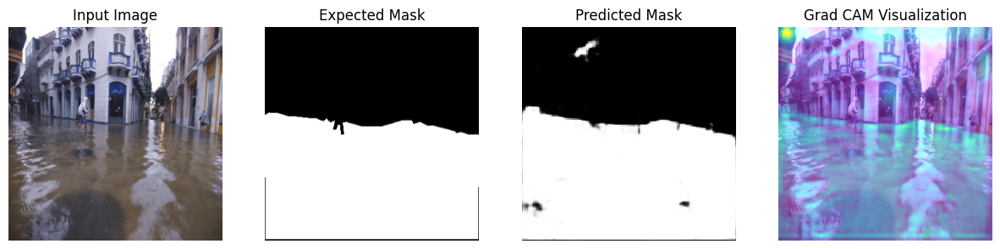

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0187 - val_loss: 0.5759
Epoch 91/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 855ms/step - loss: 0.0167 - val_loss: 0.6177
Epoch 92/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 851ms/step - loss: 0.0190 - val_loss: 0.6069
Epoch 93/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 839ms/step - loss: 0.0189 - val_loss: 0.5515
Epoch 94/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 913ms/step - loss: 0.0197 - val_loss: 0.5721
Epoch 95/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 923ms/step - loss: 0.0167 - val_loss: 0.5658
Epoch 96/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 863ms/step - loss: 0.0195 - val_loss: 0.6052
Epoch 97/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 852ms/step - loss: 0.0171 - val_loss: 0.5792
Epoch 98/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 893ms/step - loss: 0.0196 - val_loss: 0.5650
Epoch 99/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 20s 870ms/step - loss: 0.0177 - val_loss: 0.5620
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/stepep - loss: 0.01
Porcentaje de inundación: 45.10%
Porcentaje sin inundación

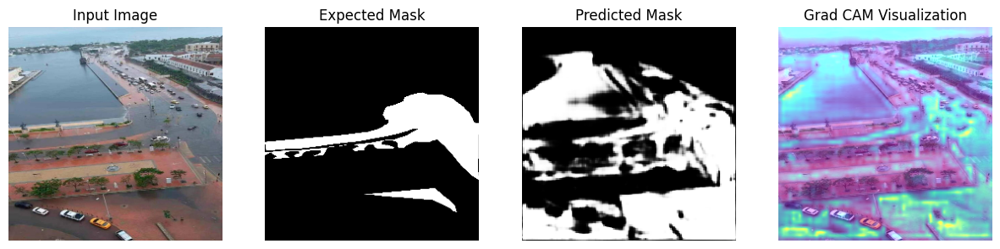

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0194 - val_loss: 0.5856


In [40]:
# Compile
DeepLabV3.compile(
    loss='binary_crossentropy',
    optimizer="adam"
)

# Callbacks
callbacks = [
    ModelCheckpoint(MODEL_NAME+".h5", save_best_only=True),
    ShowProgress()
]

# Train
history = DeepLabV3.fit(
    train_images, train_masks,
    validation_data=(test_images, test_masks),
    epochs=100,
    callbacks=callbacks,
    batch_size=2,
)

### Learning curve

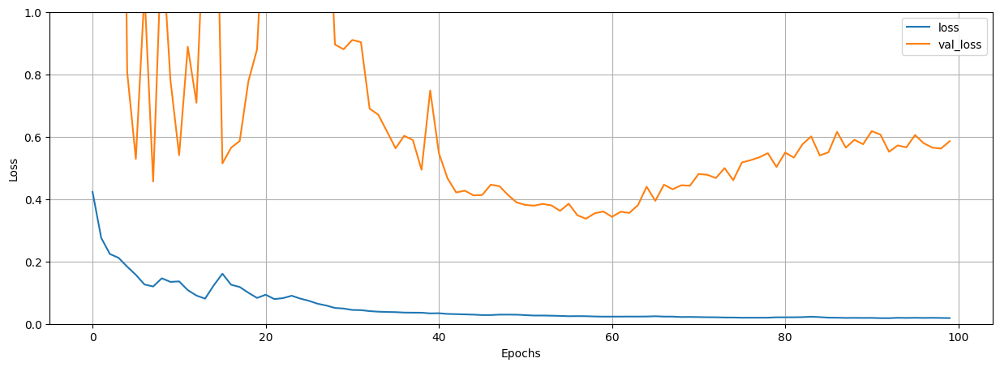

In [41]:
pd.DataFrame(history.history).plot(figsize=(15,5))
plt.ylim([0.0,1.0])
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.grid()
plt.show()

### Model predictions

Lets see how our trainded model predict:

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step
Porcentaje de inundación: 55.04%
Porcentaje sin inundación: 44.96%
Severidad: Alta 🟠


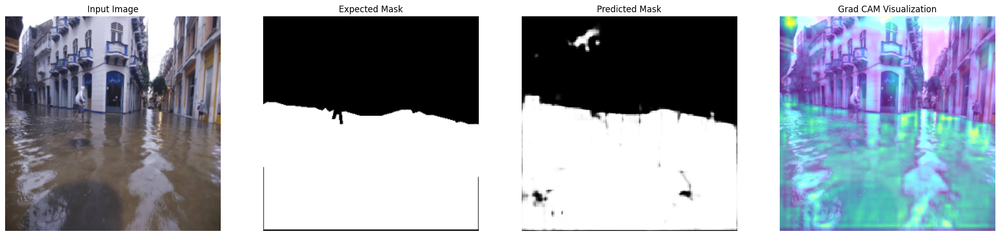

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step
Porcentaje de inundación: 39.99%
Porcentaje sin inundación: 60.01%
Severidad: Alta 🟠


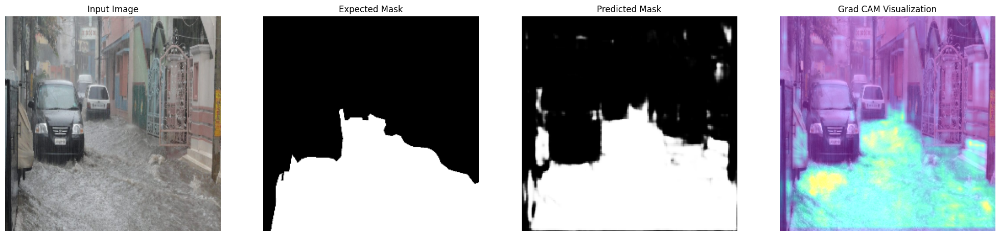

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step
Porcentaje de inundación: 37.16%
Porcentaje sin inundación: 62.84%
Severidad: Alta 🟠


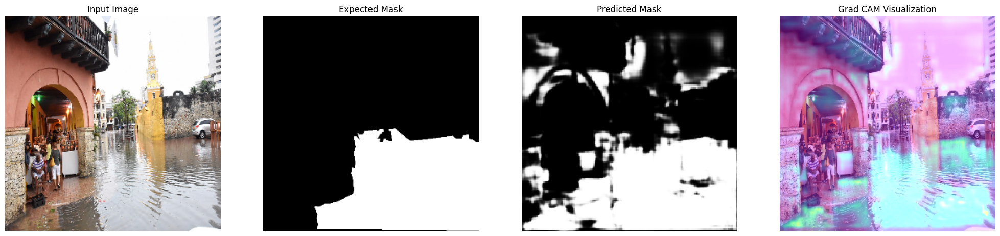

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step
Porcentaje de inundación: 39.99%
Porcentaje sin inundación: 60.01%
Severidad: Alta 🟠


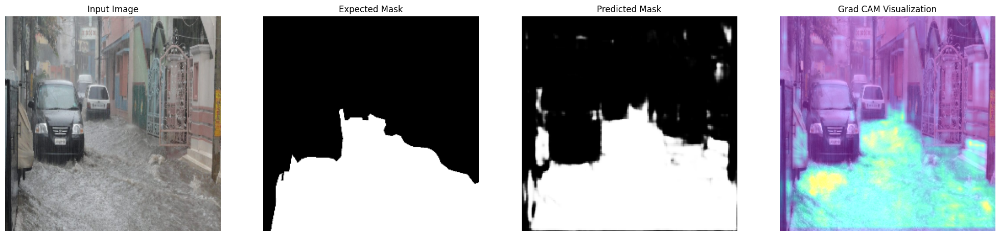

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 623ms/step
Porcentaje de inundación: 37.16%
Porcentaje sin inundación: 62.84%
Severidad: Alta 🟠


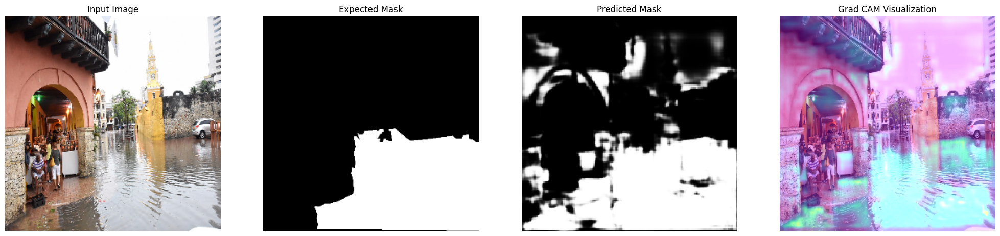

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step
Porcentaje de inundación: 39.99%
Porcentaje sin inundación: 60.01%
Severidad: Alta 🟠


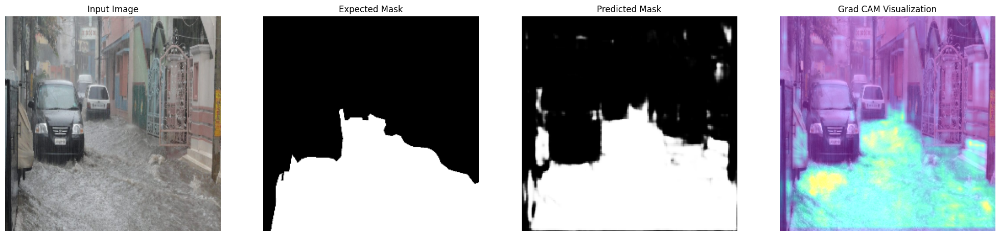

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step
Porcentaje de inundación: 39.99%
Porcentaje sin inundación: 60.01%
Severidad: Alta 🟠


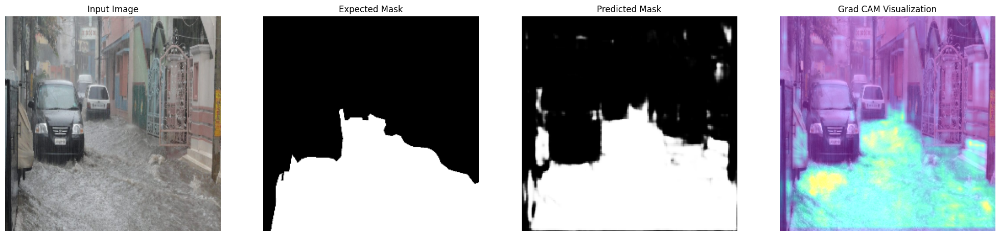

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step
Porcentaje de inundación: 36.76%
Porcentaje sin inundación: 63.24%
Severidad: Alta 🟠


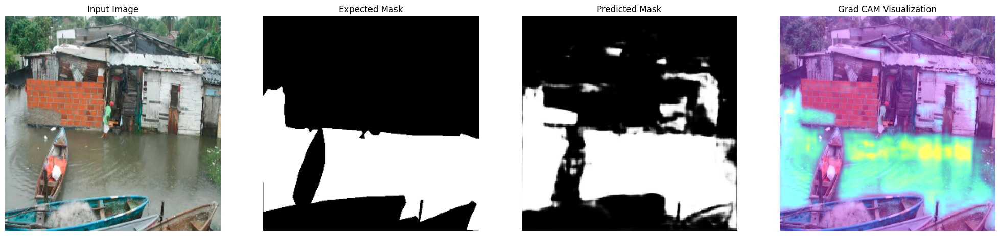

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step
Porcentaje de inundación: 48.48%
Porcentaje sin inundación: 51.52%
Severidad: Alta 🟠


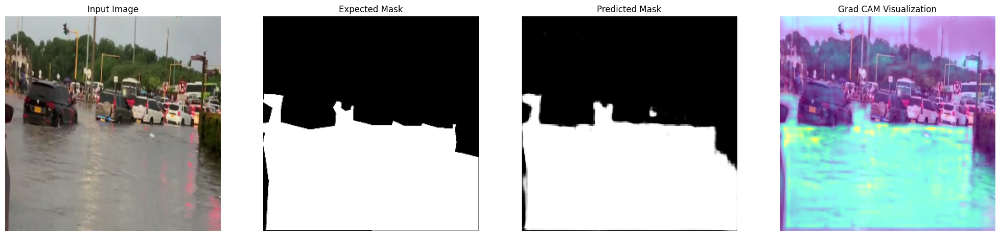

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step
Porcentaje de inundación: 37.32%
Porcentaje sin inundación: 62.68%
Severidad: Alta 🟠


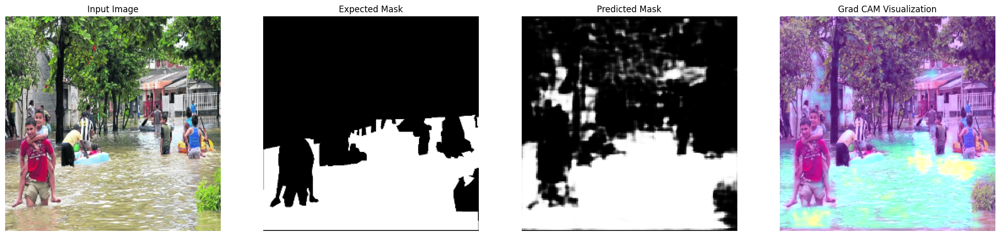

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step
Porcentaje de inundación: 48.48%
Porcentaje sin inundación: 51.52%
Severidad: Alta 🟠


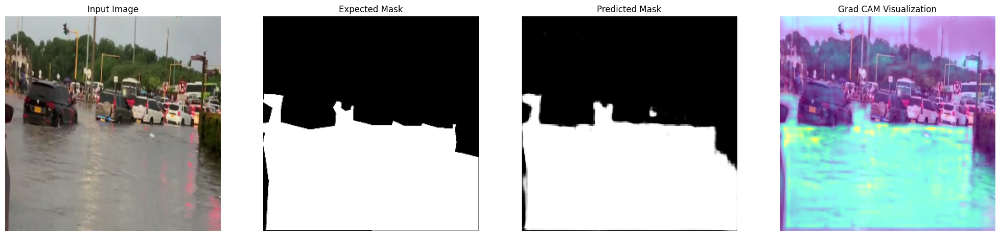

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step
Porcentaje de inundación: 48.48%
Porcentaje sin inundación: 51.52%
Severidad: Alta 🟠


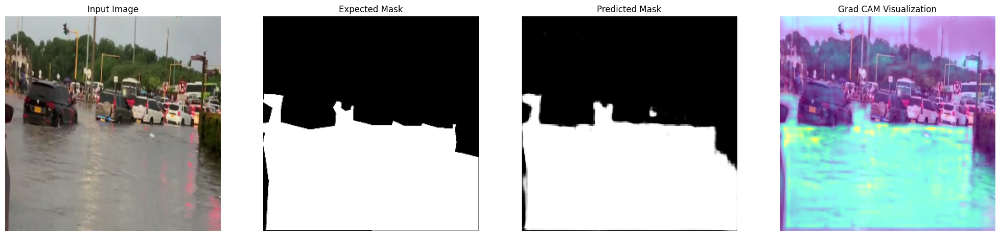

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 675ms/step
Porcentaje de inundación: 37.32%
Porcentaje sin inundación: 62.68%
Severidad: Alta 🟠


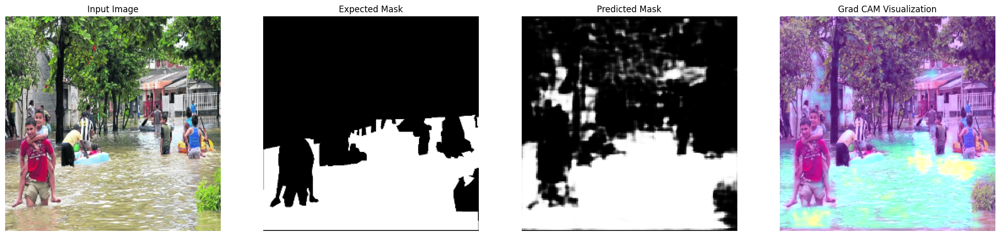

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 746ms/step
Porcentaje de inundación: 39.99%
Porcentaje sin inundación: 60.01%
Severidad: Alta 🟠


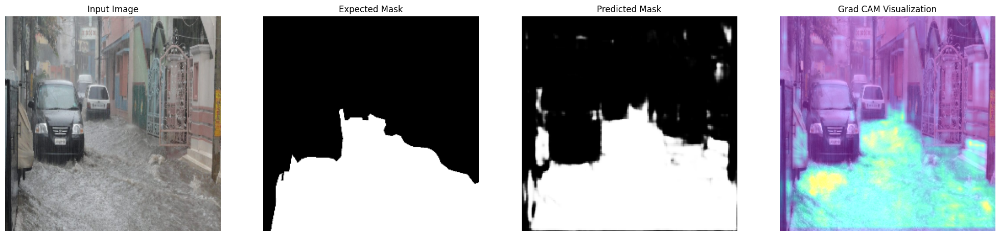

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
Porcentaje de inundación: 48.48%
Porcentaje sin inundación: 51.52%
Severidad: Alta 🟠


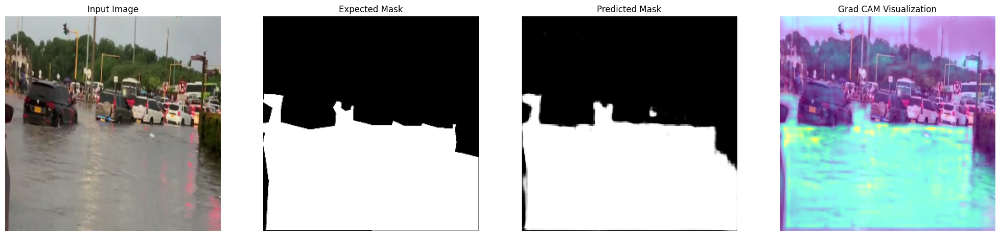

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 653ms/step
Porcentaje de inundación: 48.48%
Porcentaje sin inundación: 51.52%
Severidad: Alta 🟠


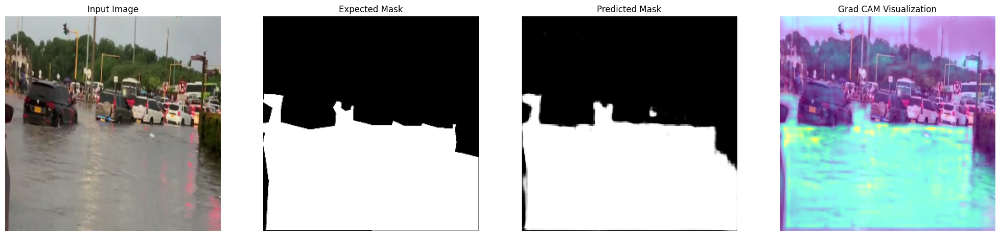

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step
Porcentaje de inundación: 55.04%
Porcentaje sin inundación: 44.96%
Severidad: Alta 🟠


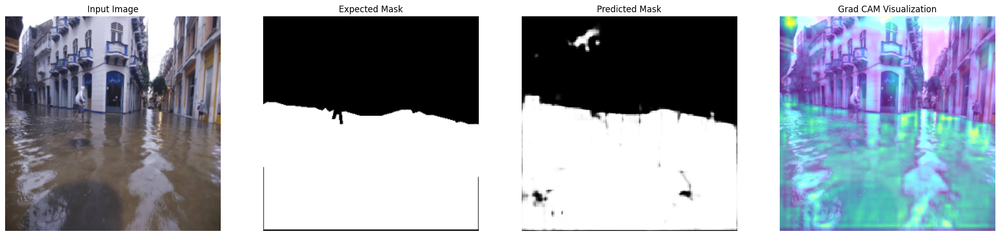

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 629ms/step
Porcentaje de inundación: 37.16%
Porcentaje sin inundación: 62.84%
Severidad: Alta 🟠


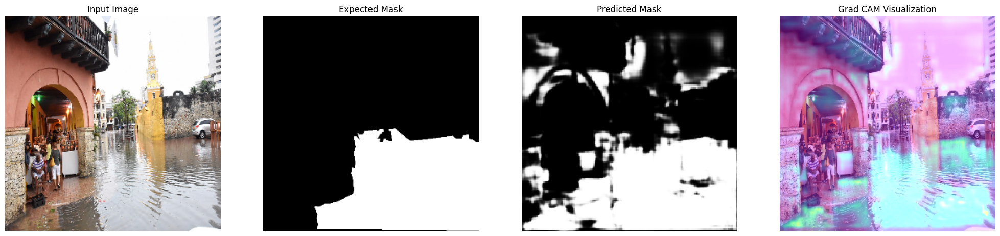

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 680ms/step
Porcentaje de inundación: 55.04%
Porcentaje sin inundación: 44.96%
Severidad: Alta 🟠


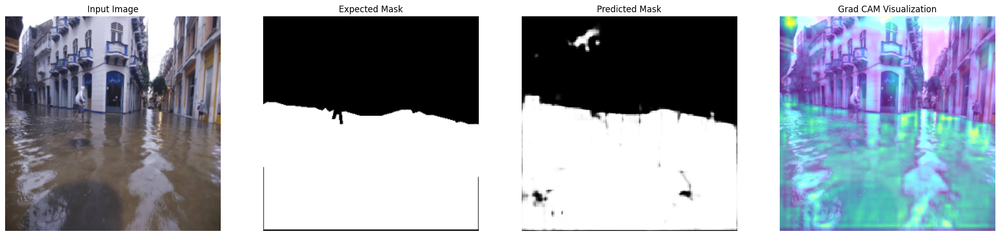

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
Porcentaje de inundación: 36.76%
Porcentaje sin inundación: 63.24%
Severidad: Alta 🟠


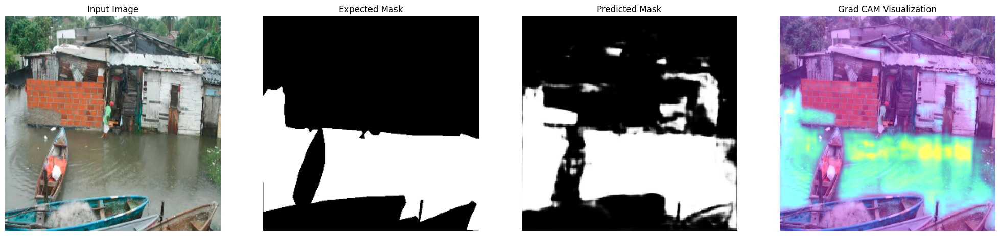

In [43]:
for i in range(20):
    show_model_preds(test_images, test_masks, model=DeepLabV3, SIZE=(25,8))